Notebook used to compare Xenium vs visium in mouse brain slides

In [1]:
import scanpy as sc
import os
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import alphashape
import geopandas as gpd
from xb.calculating import alphashape_fun

In [2]:
adatar1=sc.read('../../figures/2.comparison_between_datasets/with_regional_anno_segmented/anno_Xenium.h5ad')

In [3]:
nancells=adatar1[adatar1.obs['region_annotation']=='None']
annotatedcells=adatar1[adatar1.obs['region_annotation']!='None']
from tqdm import tqdm
nancells.obs['new_domain']='nan'
print('caclulating distance to vessel...')
for rd in tqdm(nancells.obs.index):
        meas=((annotatedcells.obs.X-nancells.obs.loc[rd,'X'])**2)+((annotatedcells.obs.Y-nancells.obs.loc[rd,'Y'])**2)
        nancells.obs.loc[rd,'new_domain']=meas.idxmin()
dican=dict(zip(annotatedcells.obs.index,annotatedcells.obs['region_annotation']))
nancells.obs['new_domain']=nancells.obs['new_domain'].map(dican)
new_assignment=dict(zip(nancells.obs.index,nancells.obs['new_domain']))
for indi in nancells.obs.index:
    adatar1.obs.loc[indi,'region_annotation']=new_assignment[indi]

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  after removing the cwd from sys.path.


caclulating distance to vessel...


100%|██████████████████████████████████████████████████████████████████████████████| 4043/4043 [00:07<00:00, 518.54it/s]


In [4]:
import json
ob=open('../../../Xenium_benchmarking-main/figures/2.comparison_between_datasets/polygons/regions_multisection_1.json')
js=json.load(ob)
output=pd.DataFrame(columns=['y','x','region_annotation','region_general'])
nu=0
for ob in js:
    for num in range(0,len(ob['coordinates'][0])):
        output.loc[nu,:]=list([ob['coordinates'][0][num][0],ob['coordinates'][0][num][1],ob['name'],ob['name'].replace(' [1]','').replace('D: ','')])
        nu=nu+1

dictio_region=dict(zip(output['region_annotation'],output['region_general']))
adatar1.obs['region_level4']=adatar1.obs['region_annotation'].map(dictio_region)
domain_level=pd.read_csv("../../data/annotation_dictionaries/ABA_domain_annotation_dictionary_whole_coronal.csv",sep=';')
lv4lv3=dict(zip(domain_level['level4'],domain_level['level3']))
lv4lv2=dict(zip(domain_level['level4'],domain_level['level2']))
lv4lv1=dict(zip(domain_level['level4'],domain_level['level1']))
adatar1.obs['region_level3']=adatar1.obs['region_level4'].map(lv4lv3)
adatar1.obs['region_level2']=adatar1.obs['region_level4'].map(lv4lv2)
adatar1.obs['region_level1']=adatar1.obs['region_level4'].map(lv4lv1)
adatar1.obs['region_level4']=adatar1.obs['region_level4'].astype(str)
lv4color=dict(zip(domain_level['level4'],domain_level['color']))
lv4color['nan']='white'
adatar1.uns['region_level4_colors']=[lv4color[el] for el in np.unique(adatar1.obs['region_level4']).astype(str)]
xenium=adatar1
xenium.var.index=[indi.lower() for indi in xenium.var.index]

# Read visium

In [5]:
vis=sc.read_visium("../../figures/2.comparison_between_datasets/ST-20221123T102627Z-001/ST/ST_fresh_frozen")
#ad=sc.read(r"/mnt/c/Users/sergio.salas/Downloads/ST_fresh_frozen.h5ad")
visiumFF=sc.read(r"../../figures/2.comparison_between_datasets/with_regional_anno/anno_ST_FF.h5ad")
subsetad=vis[visiumFF.obs.index]
subsetad.var.index=list([x.lower() for x in subsetad.var.index])
ss=subsetad[:,subsetad.var.index.isin(visiumFF.var.index)]
locdict=dict(zip(visiumFF.obs.index,visiumFF.obs['spatial annotation']))
locdictX=dict(zip(visiumFF.obs.index,visiumFF.obs['x']))
locdictY=dict(zip(visiumFF.obs.index,visiumFF.obs['y']))

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
ss.obs['spatial annotation']=ss.obs.index.map(locdict)
ss.obs['x']=ss.obs.index.map(locdictX)
ss.obs['y']=ss.obs.index.map(locdictY)
ss.X=ss.X.todense()
visiumFF=ss

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.


<AxesSubplot:xlabel='x', ylabel='y'>

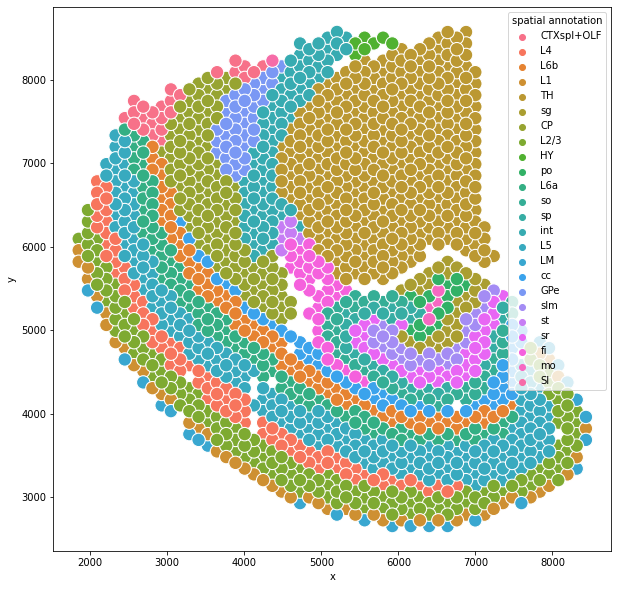

In [7]:
plt.figure(figsize=(10,10))
sns.scatterplot(x=visiumFF.obs['x'],y=visiumFF.obs['y'],s=180,hue=visiumFF.obs['spatial annotation'])

In [8]:
xenium.obsm['spatial']=np.array(xenium.obs.loc[:,['Y','X']])

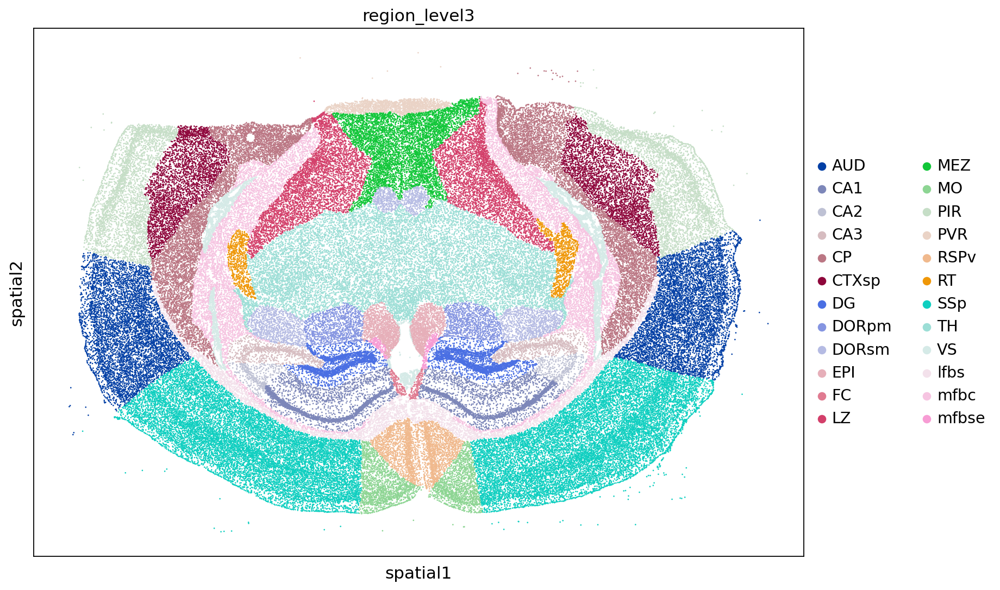

In [9]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(xenium,color='region_level3',spot_size=100)

<AxesSubplot:xlabel='x', ylabel='y'>

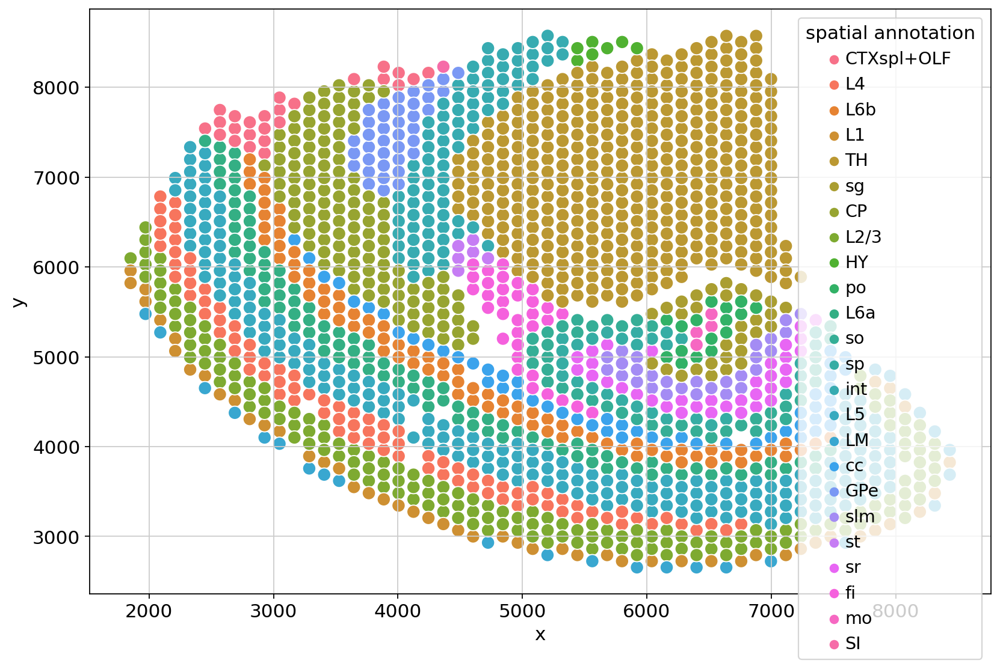

In [10]:
plt.figure()
sns.scatterplot(x=visiumFF.obs['x'],y=visiumFF.obs['y'],s=100,hue=visiumFF.obs['spatial annotation'])

# Calculating for areas for ST and xen

For visium, the coord to UM conversion ratio is 0.7299270072992701. Minimum distance between spots found is 137, in reality (um) it's 100 um

In [28]:
regions=['L1','L2/3','L4','L5','L6a','L6b']#,'sp','cc','slm','so','mo','po','sr','sg']
visiumFF.var.index=list([x.lower() for x in visiumFF.var.index])
visiumFF_CTX=visiumFF[visiumFF.obs['spatial annotation'].isin(regions)]
xenium_CTX=xenium[xenium.obs['region_level3'].isin(['SSp','AUD','MO','RSPv'])]
visiumexpress=pd.DataFrame((visiumFF_CTX.X),columns=visiumFF_CTX.var.index)
xeniumexpress=pd.DataFrame((xenium_CTX.X),columns=xenium_CTX.var.index)

In [29]:
# Format the XY coordinates into points as tuples
convex_hull_area = alphashape_fun(visiumFF_CTX.obsm['spatial']*0.7299270072992701,alpha=0.001)
print("Area of the convex hull:"+str(convex_hull_area/(10**6))+ 'um2')
ST_CTX_um=convex_hull_area/(10**6)
# Format the XY coordinates into points as tuples
# Format the XY coordinates into points as tuples
#points = [(x, y) for x, y in xenium_CTX.obsm['spatial']/4.70588]
delunay_agg_area = alphashape_fun(xenium_CTX.obsm['spatial']/4.70588,alpha=0.01)
print("Area of the convex hull: "+ str(delunay_agg_area/(10**6))+ 'um2')
xenium_CTX_um=delunay_agg_area/(10**6)

Area of the Alpha Shape (Concave Hull): 5862245.990729394
Area of the convex hull:5.862245990729394um2
Area of the Alpha Shape (Concave Hull): 14940600.893848842
Area of the convex hull: 14.940600893848842um2


# Calculate the genexp_ratio,considering the areas

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  from ipykernel import kernelapp as app


Median ratio is 26.822795738197417


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:31: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.


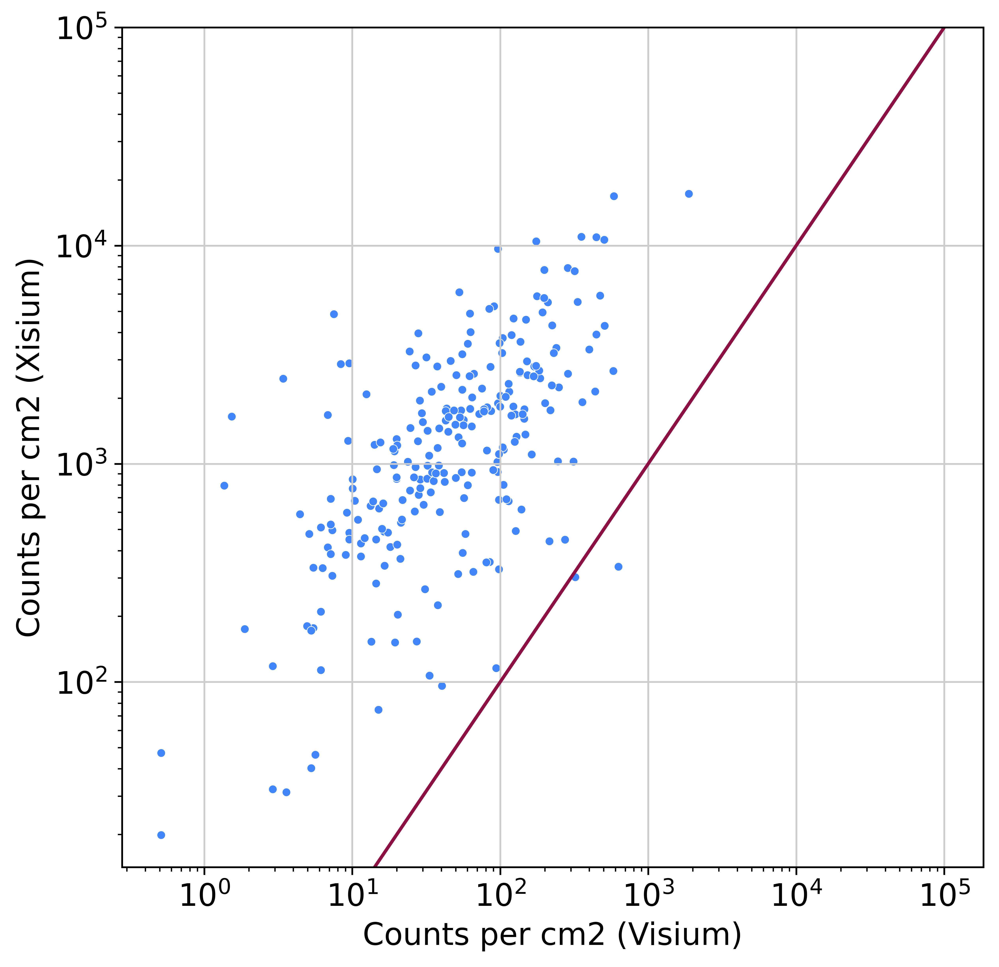

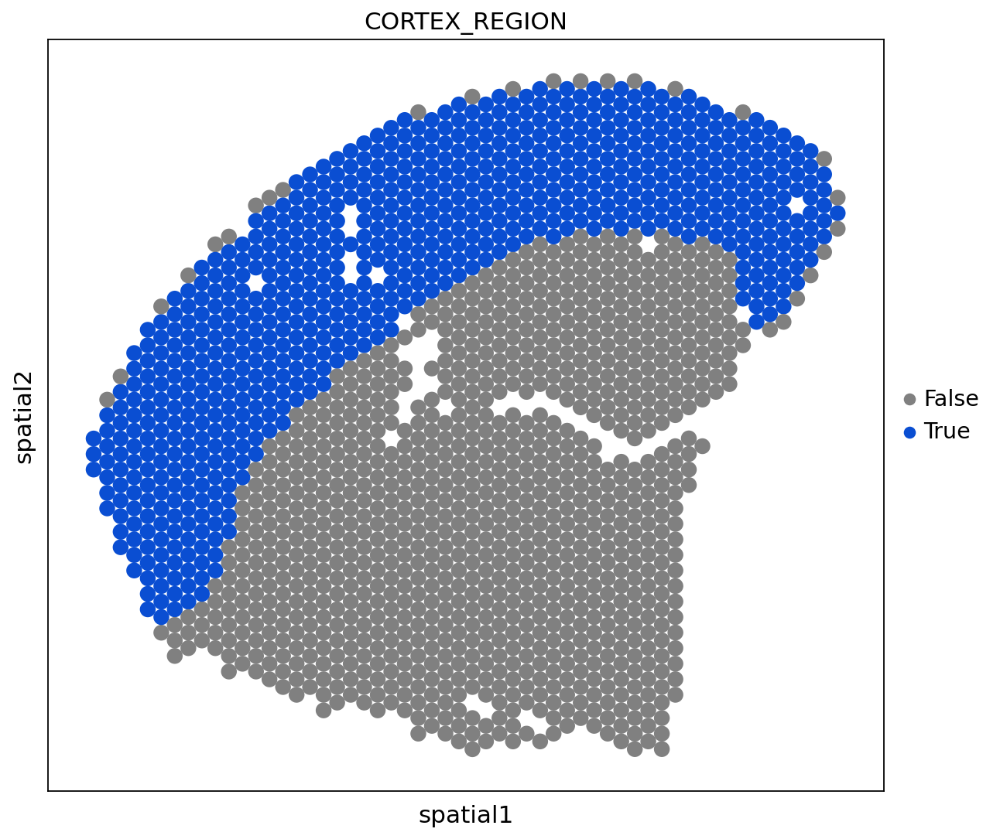

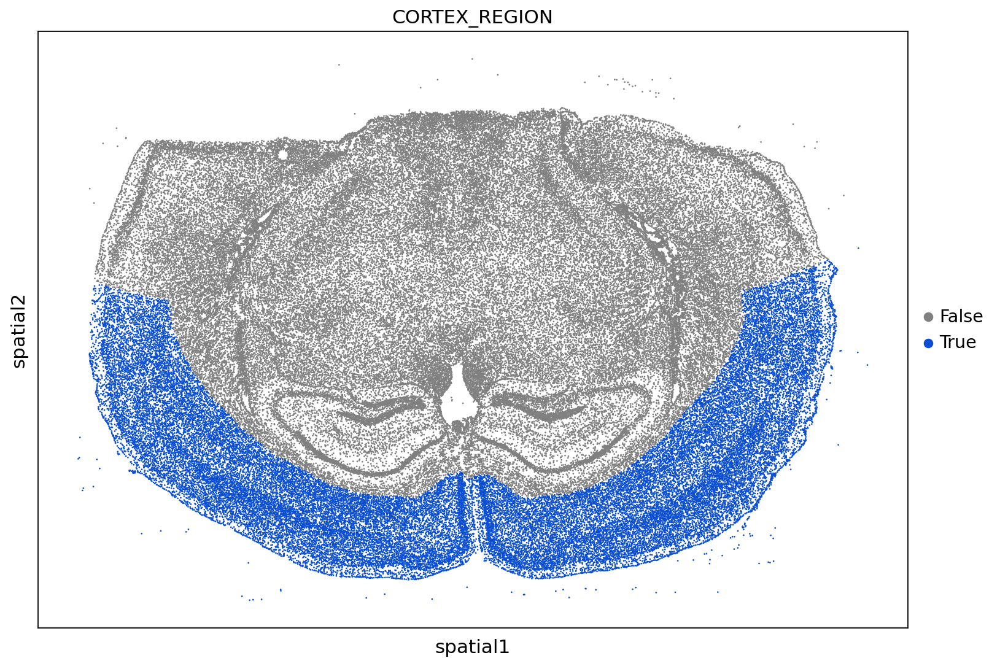

In [30]:
ST_XEN_AREA_RATIO=ST_CTX_um/xenium_CTX_um
visiumexpress=pd.DataFrame((visiumFF_CTX.X),columns=visiumFF_CTX.var.index)
xeniuamexpress=pd.DataFrame((xenium_CTX.X),columns=xenium_CTX.var.index)
gn=[]
rat=[]
valxen=[]
valvis=[]
for gene in xeniumexpress.columns:
    if gene in visiumexpress.columns:
        t1=np.sum(xeniumexpress.loc[:,gene])
        t2=np.sum(visiumexpress.loc[:,gene])
        valxen.append(t1/xenium_CTX_um)
        valvis.append(t2/ST_CTX_um)
        gn.append(gene)
        ratio=(t1*ST_XEN_AREA_RATIO)/t2
        rat.append(ratio)

expre=pd.DataFrame([gn,rat,valxen,valvis],index=['gene','ratio','xenium','visium']).transpose()
np.mean(expre['ratio'])
print('Median ratio is '+str(np.median(expre['ratio'])))

sc.set_figure_params(scanpy=True, dpi=400,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(7,7))
sns.scatterplot(expre['visium'],expre['xenium'],s=15,color='#4287f5')
plt.xscale('log')
plt.yscale('log')
plt.ylim(0,100000)
#plt.ylim(bottom=0)
x = np.linspace(0,100000)
y = 1*x
plt.plot(x, y,color='#8c1044')
plt.xlabel('Counts per cm2 (Visium)')
plt.ylabel('Counts per cm2 (Xisium)')
plt.savefig('../../figures/2.comparison_between_datasets/visiumFF_vs_Xenium_REVISION.pdf')

regions_CTX=['L1','L2/3','L4','L5','L6a','L6b','SSp','AUD','MO','RSPv']
visiumFF.var.index=list([x.lower() for x in visiumFF.var.index])
visiumFF.obsm['spatial']=np.array(visiumFF.obs.loc[:,['x','y']])
visiumFF.obs['CORTEX_REGION']=visiumFF.obs['spatial annotation'].isin(regions_CTX).astype(str)
xenium.obs['CORTEX_REGION']=xenium.obs['region_level3'].isin(regions_CTX).astype(str)
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(visiumFF,color='CORTEX_REGION',spot_size=140,palette=['grey','#0A4ED2'],img_key=None,save='VISIUM_CORTEX_XV_COMPARISON.pdf')
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(xenium,color='CORTEX_REGION',spot_size=100,palette=['grey','#0A4ED2'],save='XENIUM_CORTEX_XV_COMPARISON.pdf')

# Total counts comparison

In [21]:
total_counts_sqcm_Visium=np.sum(np.sum(visiumexpress))/ST_CTX_um
total_counts_sqcm_Xenium=np.sum(np.sum(xeniumexpress))/xenium_CTX_um
total_counts_sqcm_Visium / total_counts_sqcm_Xenium

6.984904381791192

# HYPPOCAMPUS

In [22]:
regions=['sp','slm','so','mo','po','sr','sg']
visiumFF.var.index=list([x.lower() for x in visiumFF.var.index])
visiumFF_CTX=visiumFF[visiumFF.obs['spatial annotation'].isin(regions)]
xenium_CTX=xenium[xenium.obs['region_level3'].isin(['DG','CA1','CA2','CA3'])]
# Format the XY coordinates into points as tuples
convex_hull_area = alphashape_fun(visiumFF_CTX.obsm['spatial']*0.7299270072992701,alpha=0.001)
print("Area of the convex hull:"+str(convex_hull_area/(10**6))+ 'um2')
ST_CTX_um=convex_hull_area/(10**6)
# Format the XY coordinates into points as tuples
#points = [(x, y) for x, y in xenium_CTX.obsm['spatial']/4.70588]
delunay_agg_area = alphashape_fun(xenium_CTX.obsm['spatial']/4.70588,alpha=0.01)
print("Area of the convex hull: "+ str(delunay_agg_area/(10**6))+ 'um2')
xenium_CTX_um=delunay_agg_area/(10**6)

Area of the Alpha Shape (Concave Hull): 1469917.68341414
Area of the convex hull:1.46991768341414um2
Area of the Alpha Shape (Concave Hull): 4817281.631449434
Area of the convex hull: 4.8172816314494336um2


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  from ipykernel import kernelapp as app
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:32: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.


Median ratio is 15.290087242661055


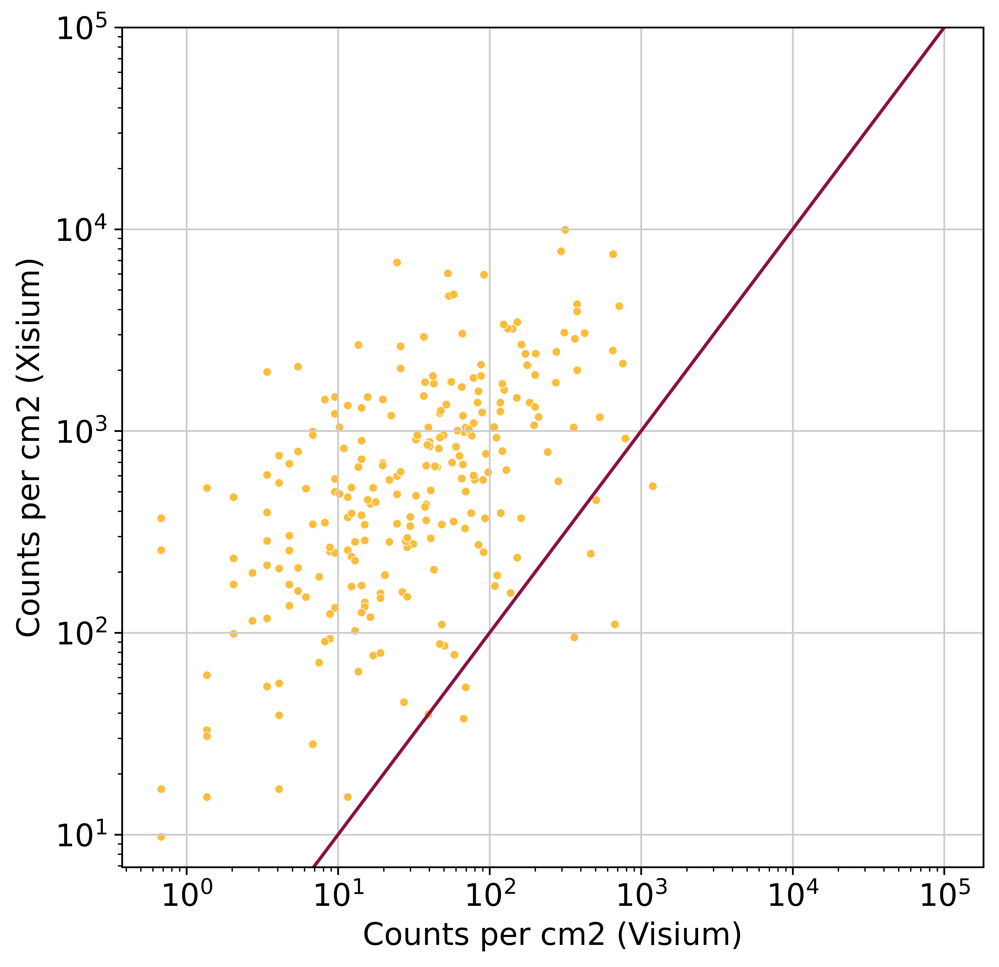

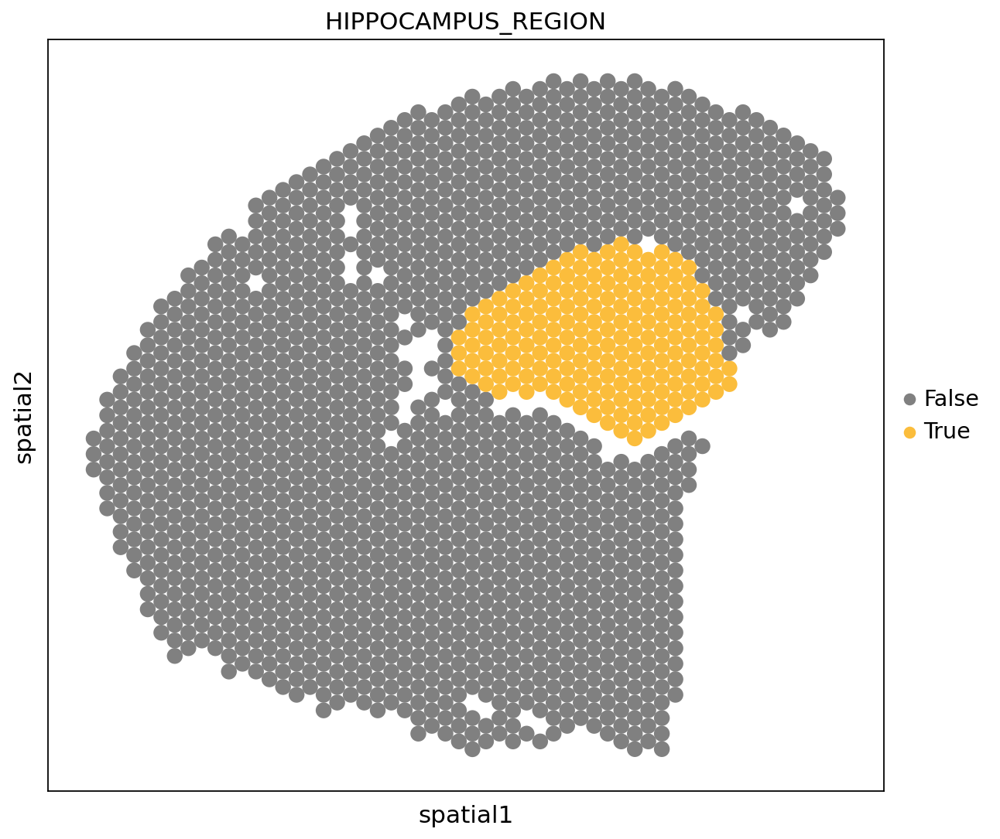

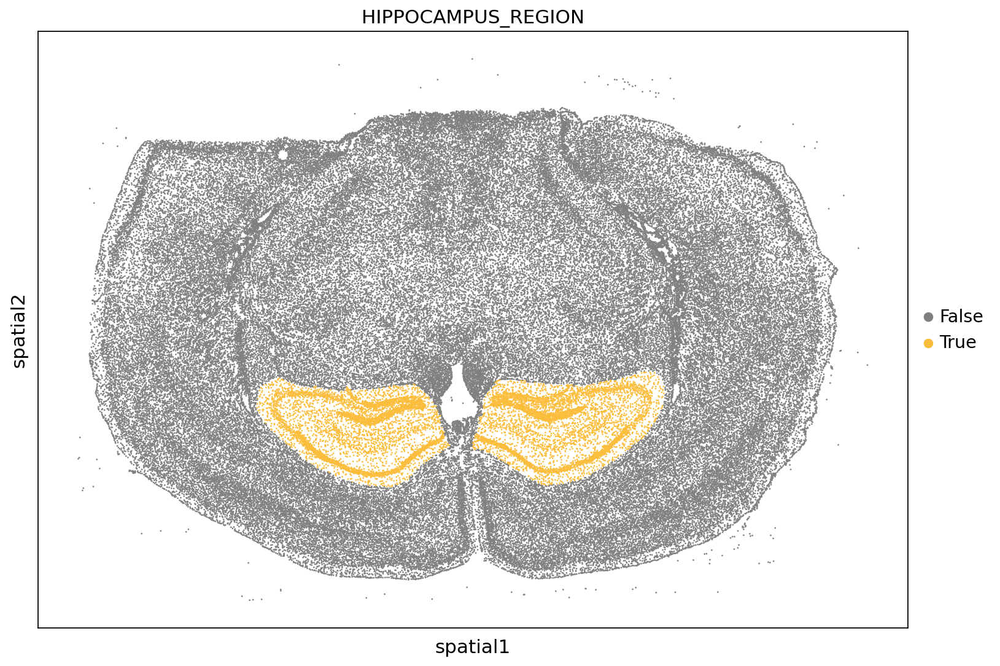

In [23]:
ST_XEN_AREA_RATIO=ST_CTX_um/xenium_CTX_um
visiumexpress=pd.DataFrame((visiumFF_CTX.X),columns=visiumFF_CTX.var.index)
xeniumexpress=pd.DataFrame((xenium_CTX.X),columns=xenium_CTX.var.index)
gn=[]
rat=[]
valxen=[]
valvis=[]
for gene in xeniumexpress.columns:
    if gene in visiumexpress.columns:
        t1=np.sum(xeniumexpress.loc[:,gene])
        t2=np.sum(visiumexpress.loc[:,gene])
        valxen.append(t1/xenium_CTX_um)
        valvis.append(t2/ST_CTX_um)
        gn.append(gene)
        ratio=(t1*ST_XEN_AREA_RATIO)/t2
        rat.append(ratio)

expre=pd.DataFrame([gn,rat,valxen,valvis],index=['gene','ratio','xenium','visium']).transpose()
expre=expre[expre['ratio']!=np.inf]
np.mean(expre['ratio'])
print('Median ratio is '+str(np.median(expre['ratio'])))

sc.set_figure_params(scanpy=True, dpi=400,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(7,7))
sns.scatterplot(expre['visium'],expre['xenium'],s=15,color='#fbbd3c')
plt.xscale('log')
plt.yscale('log')
plt.ylim(0,100000)
#plt.ylim(bottom=0)
x = np.linspace(0,100000)
y = 1*x
plt.plot(x, y,color='#8c1044')
plt.xlabel('Counts per cm2 (Visium)')
plt.ylabel('Counts per cm2 (Xisium)')
plt.savefig('../../figures/2.comparison_between_datasets/visiumFF_vs_Xenium_REVISION_HIPPOCAMPUS.pdf')
regions_CTX=['sp','slm','so','mo','po','sr','sg','DG','CA1','CA2','CA3']
visiumFF.var.index=list([x.lower() for x in visiumFF.var.index])
visiumFF.obsm['spatial']=np.array(visiumFF.obs.loc[:,['x','y']])
visiumFF.obs['HIPPOCAMPUS_REGION']=visiumFF.obs['spatial annotation'].isin(regions_CTX).astype(str)
xenium.obs['HIPPOCAMPUS_REGION']=xenium.obs['region_level3'].isin(regions_CTX).astype(str)
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(visiumFF,color='HIPPOCAMPUS_REGION',spot_size=140,palette=['grey','#fbbd3c'],img_key=None,save='VISIUM_HIPPOCAMPUS_XV_COMPARISON.pdf')
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(xenium,color='HIPPOCAMPUS_REGION',spot_size=100,palette=['grey','#fbbd3c'],save='XENIUM_HIPPOCAMPUS_XV_COMPARISON.pdf')

# Total counts comparison in Hyppocampus

In [24]:
total_counts_sqcm_Visium=np.sum(np.sum(visiumexpress))/ST_CTX_um
total_counts_sqcm_Xenium=np.sum(np.sum(xeniumexpress))/xenium_CTX_um
print('Vis/Xen ratio difference '+str(total_counts_sqcm_Visium / total_counts_sqcm_Xenium)+' for all counts')

Vis/Xen ratio difference 12.881253797695605 for all counts


# Thalamus

In [25]:
regions=['TH','DORpm','DORsm']
visiumFF.var.index=list([x.lower() for x in visiumFF.var.index])
visiumFF_CTX=visiumFF[visiumFF.obs['spatial annotation'].isin(regions)]
xenium_CTX=xenium[xenium.obs['region_level3'].isin(['TH','DORpm','DORsm'])]
# Format the XY coordinates into points as tuples
convex_hull_area = alphashape_fun(visiumFF_CTX.obsm['spatial']*0.7299270072992701,alpha=0.001)
print("Area of the convex hull:"+str(convex_hull_area/(10**6))+ 'um2')
ST_CTX_um=convex_hull_area/(10**6)
# Format the XY coordinates into points as tuples
#points = [(x, y) for x, y in xenium_CTX.obsm['spatial']/4.70588]
delunay_agg_area = alphashape_fun(xenium_CTX.obsm['spatial']/4.70588,alpha=0.01)
print("Area of the convex hull: "+ str(delunay_agg_area/(10**6))+ 'um2')
xenium_CTX_um=delunay_agg_area/(10**6)

Area of the Alpha Shape (Concave Hull): 3194790.0793862217
Area of the convex hull:3.194790079386222um2
Area of the Alpha Shape (Concave Hull): 7578154.228229481
Area of the convex hull: 7.578154228229481um2


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  from ipykernel import kernelapp as app


Median ratio is 12.60645813328357


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:32: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.


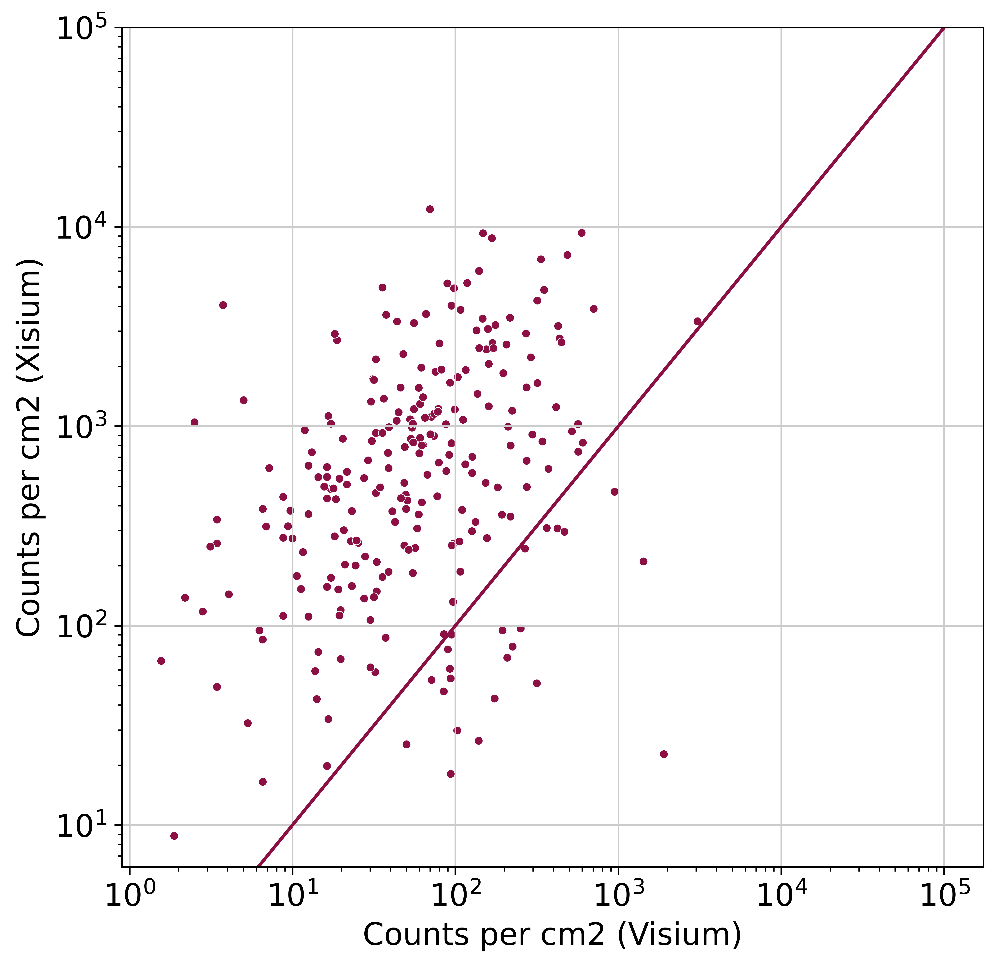

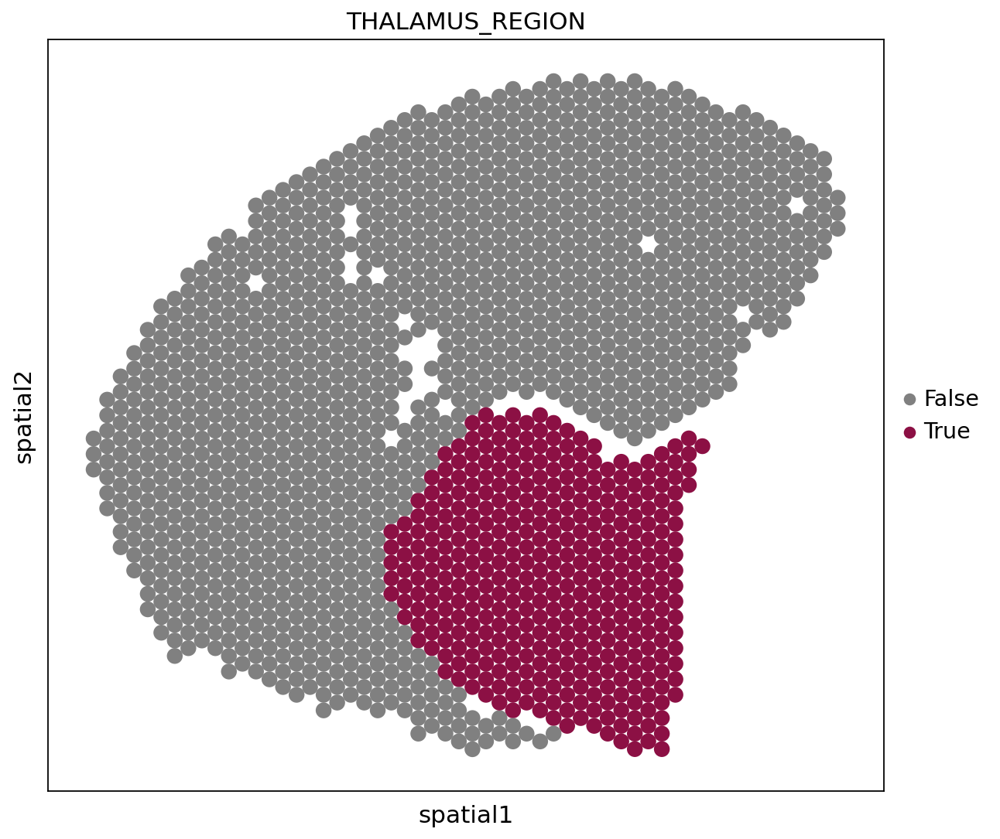

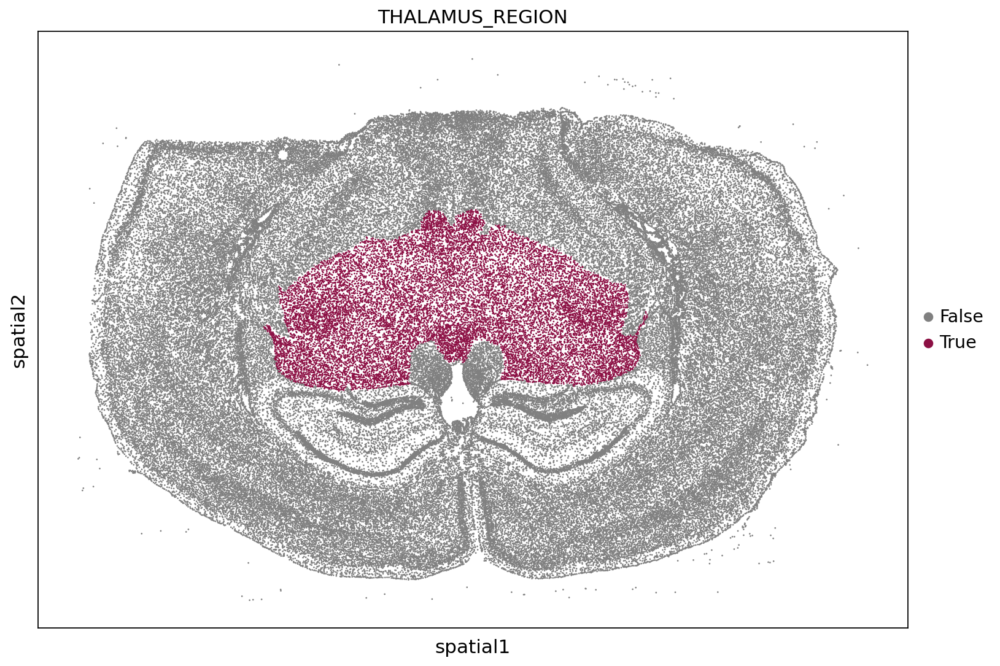

In [26]:
ST_XEN_AREA_RATIO=ST_CTX_um/xenium_CTX_um
visiumexpress=pd.DataFrame((visiumFF_CTX.X),columns=visiumFF_CTX.var.index)
xeniumexpress=pd.DataFrame((xenium_CTX.X),columns=xenium_CTX.var.index)
gn=[]
rat=[]
valxen=[]
valvis=[]
for gene in xeniumexpress.columns:
    if gene in visiumexpress.columns:
        t1=np.sum(xeniumexpress.loc[:,gene])
        t2=np.sum(visiumexpress.loc[:,gene])
        valxen.append(t1/xenium_CTX_um)
        valvis.append(t2/ST_CTX_um)
        gn.append(gene)
        ratio=(t1*ST_XEN_AREA_RATIO)/t2
        rat.append(ratio)

expre=pd.DataFrame([gn,rat,valxen,valvis],index=['gene','ratio','xenium','visium']).transpose()
expre=expre[expre['ratio']!=np.inf]
np.mean(expre['ratio'])
print('Median ratio is '+str(np.median(expre['ratio'])))

sc.set_figure_params(scanpy=True, dpi=400,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(7,7))
sns.scatterplot(expre['visium'],expre['xenium'],s=15,color='#8c1044')
plt.xscale('log')
plt.yscale('log')
plt.ylim(0,100000)
#plt.ylim(bottom=0)
x = np.linspace(0,100000)
y = 1*x
plt.plot(x, y,color='#8c1044')
plt.xlabel('Counts per cm2 (Visium)')
plt.ylabel('Counts per cm2 (Xisium)')
plt.savefig('../../figures/2.comparison_between_datasets/visiumFF_vs_Xenium_REVISION_THALAMUS.pdf')
regions_CTX=['TH','DORpm','DORsm']
visiumFF.var.index=list([x.lower() for x in visiumFF.var.index])
visiumFF.obsm['spatial']=np.array(visiumFF.obs.loc[:,['x','y']])
visiumFF.obs['THALAMUS_REGION']=visiumFF.obs['spatial annotation'].isin(regions_CTX).astype(str)
xenium.obs['THALAMUS_REGION']=xenium.obs['region_level3'].isin(regions_CTX).astype(str)
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(visiumFF,color='THALAMUS_REGION',spot_size=140,palette=['grey','#8c1044'],img_key=None,save='VISIUM_THALAMUS_XV_COMPARISON.pdf')
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(12,8), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.spatial(xenium,color='THALAMUS_REGION',spot_size=100,palette=['grey','#8c1044'],save='XENIUM_THALAMUS_XV_COMPARISON.pdf')

# Get the number of probe sets used by Xenium

In [50]:
translength=pd.read_csv('../../figures/2.comparison_between_datasets/transcript_length.csv')
translength['gene']=[g.lower() for g in translength['gene']]

In [51]:
lendic=dict(zip(translength['gene'],translength['transcript_length']))

In [31]:
PLPs_xenium=pd.read_csv('../../data/annotation_dictionaries/mBrain_v1_panel_nprobes.csv',header=None)
PLPs_xenium.columns=['Gene','ID','nprobes','sets','celltype']
PLPs_xenium['Gene']=[g.lower() for g in PLPs_xenium['Gene']]
nprobedic=dict(zip(PLPs_xenium['Gene'],PLPs_xenium['nprobes']))
PLPs_xenium=pd.read_csv('../../data/annotation_dictionaries/mBrain_v1_panel_nprobes_real_sequences.csv')
#PLPs_xenium.columns=['Gene','ID','nprobes','sets','celltype']
PLPs_xenium['gene']=[g.lower() for g in PLPs_xenium['gene']]
nprobedic_all=dict(zip(PLPs_xenium['gene'],PLPs_xenium['nprobes']))
expre['nprobes']=expre['gene'].map(nprobedic)
expre['nprobes_all']=expre['gene'].map(nprobedic_all)
expre['transcript_length']=expre['gene'].map(lendic)

In [52]:
expre['nprobes']=expre['gene'].map(nprobedic)
expre['nprobes_all']=expre['gene'].map(nprobedic_all)
expre['transcript_length']=expre['gene'].map(lendic)

In [45]:
expre

,gene,ratio,xenium,visium,nprobes,nprobes_all,transcript_length
0,2010300c02rik,16.563239,5523.673418,333.489929,8,20.0,NaN
1,acsbg1,9.011924,2587.245337,287.09133,7,20.0,NaN
2,acta2,14.224462,912.34617,64.13924,8,18.0,NaN
3,acvrl1,36.063066,965.824608,26.781544,8,20.0,NaN
4,adamts2,23.016582,416.181387,18.081807,8,29.0,NaN
...,...,...,...,...,...,...,...
242,vwc2l,65.017666,676.545748,10.405568,8,21.0,NaN
243,wfs1,8.058609,1759.567784,218.346347,8,20.0,NaN
244,zfp366,52.736671,332.851405,6.311574,8,20.0,NaN
245,zfp536,36.121459,1756.087335,48.616179,8,20.0,NaN


In [61]:
expre2=expre[~expre['nprobes_all'].isna()]

In [62]:
expre3=expre[~expre['transcript_length'].isna()]

In [542]:
np.corrcoef(expre2['nprobes_all'].astype(int),expre2['ratio'].astype(float))

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/numpy/lib/function_base.py:2536: RuntimeWarning: invalid value encountered in subtract
  X -= avg[:, None]


array([[ 1., nan],
       [nan, nan]])

In [543]:
np.corrcoef(expre2['nprobes_all'].astype(int),expre2['nprobes'].astype(float))

array([[1.        , 0.41176681],
       [0.41176681, 1.        ]])

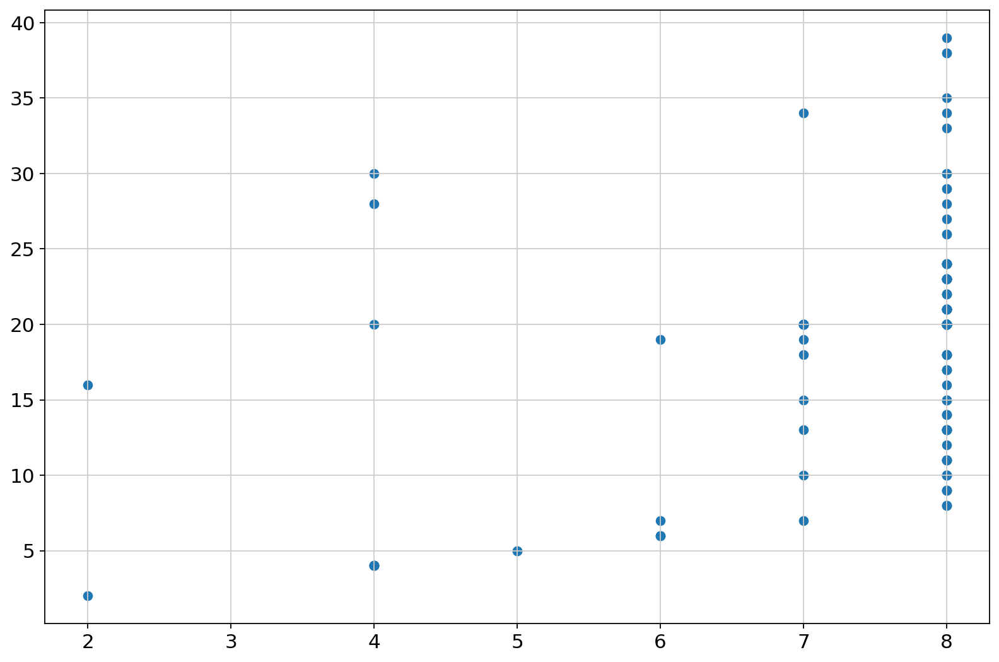

In [544]:
plt.scatter(expre['nprobes'],expre['nprobes_all'])

In [74]:
expre3=expre3[expre3['ratio']!=np.inf]

In [76]:
np.corrcoef(expre3['ratio'].astype(float),expre3['transcript_length'].astype(float))


array([[1.        , 0.13311317],
       [0.13311317, 1.        ]])

(-10.0, 200.0)

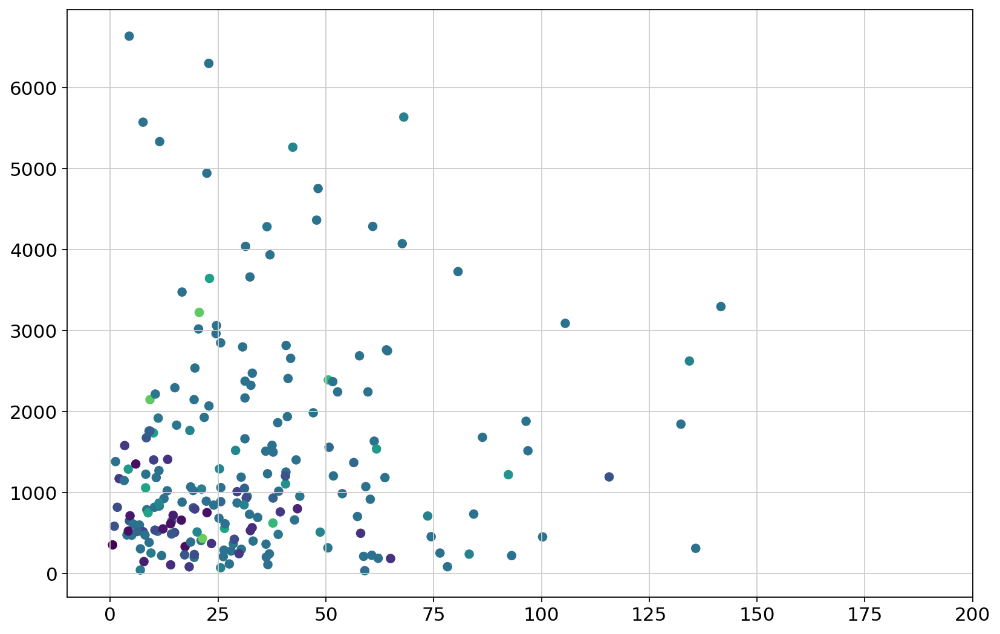

In [79]:
plt.scatter(expre['ratio'],expre['transcript_length'],c=expre['nprobes_all'],vmax=50)
plt.xlim([-10,200])

In [ ]:
plt.scatter(expre['visium'],expre['transcript_length'],vmax=50)


(0.0, 600.0)

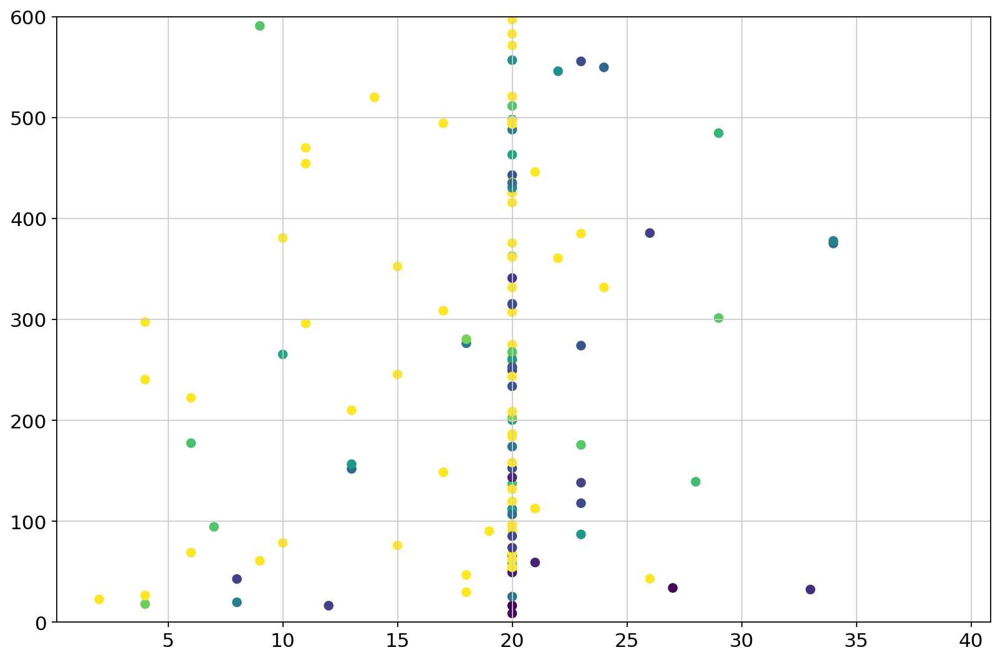

In [545]:
plt.scatter(expre['nprobes_all'],expre['xenium'],c=expre['visium'],vmax=50)
plt.ylim([0,600])

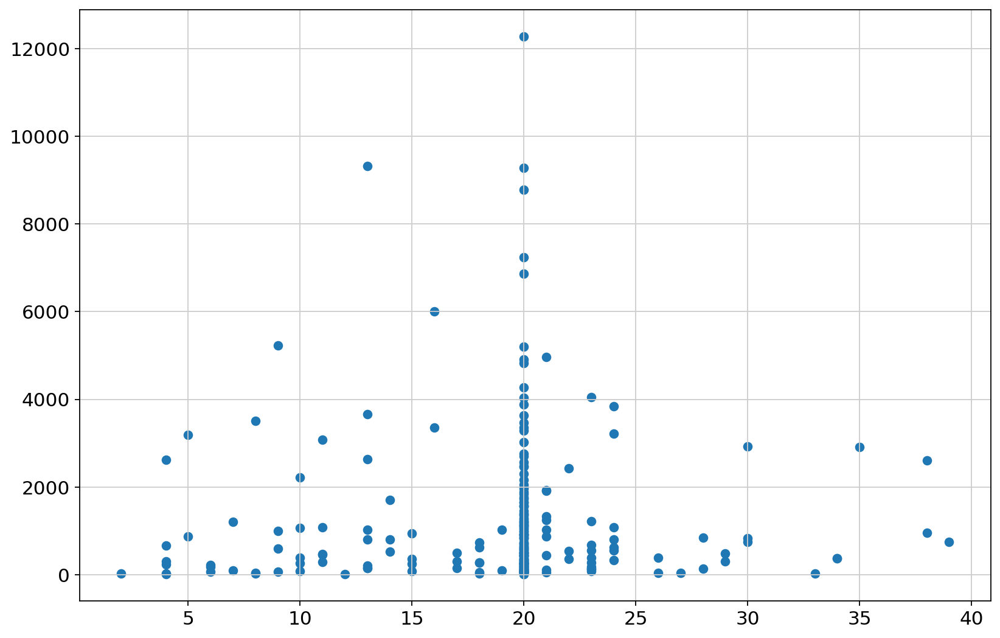

In [546]:
plt.scatter(expre['nprobes_all'],expre['xenium'])

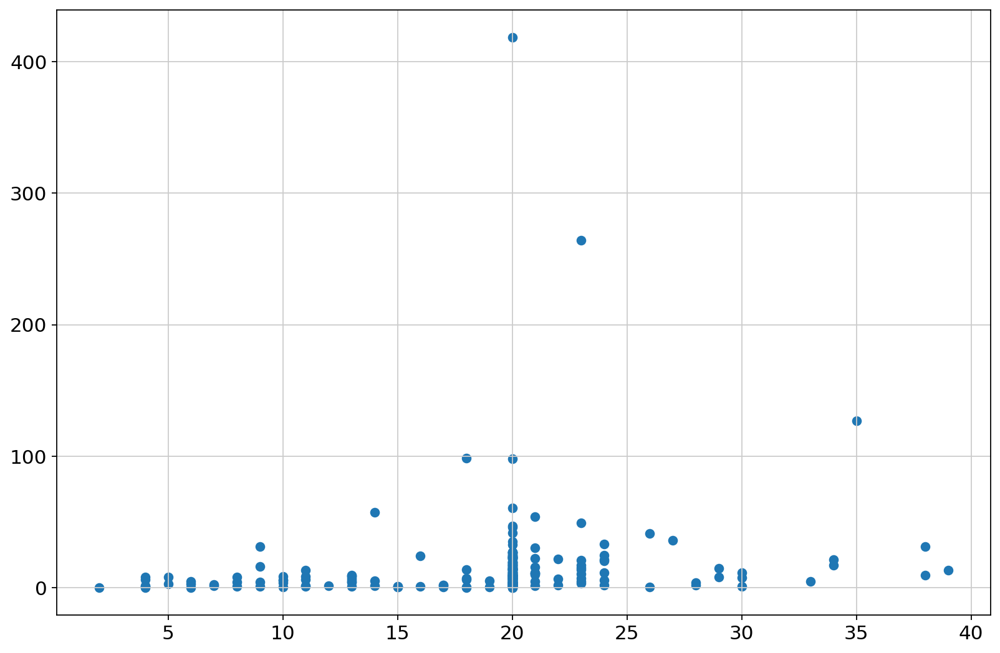

In [547]:
plt.scatter(expre['nprobes_all'],expre['ratio'])

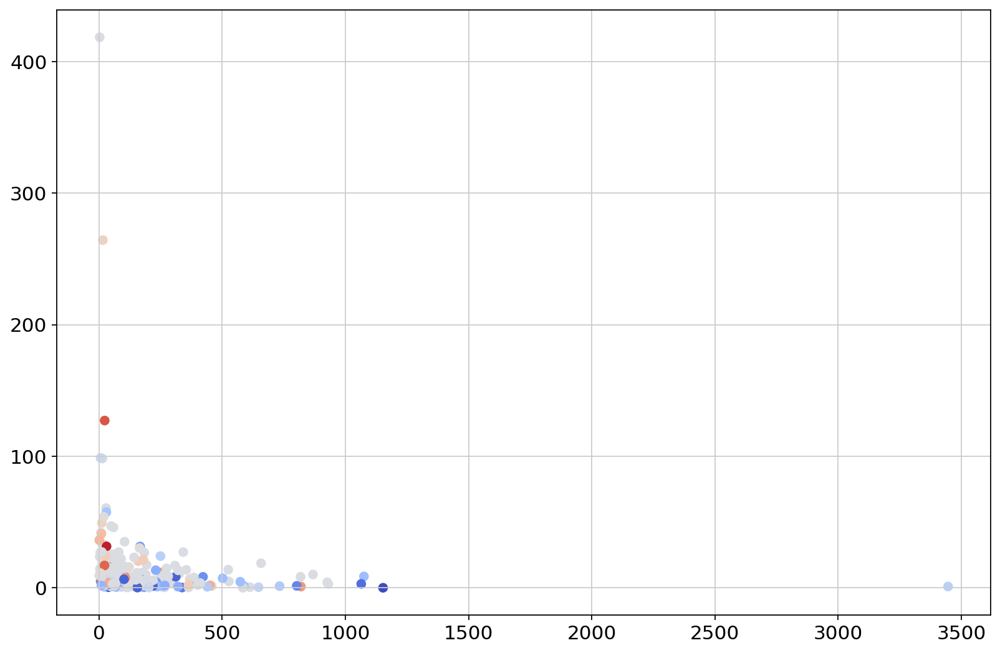

In [548]:
plt.scatter(expre['visium'],expre['ratio'],c=expre['nprobes_all'],cmap='coolwarm')

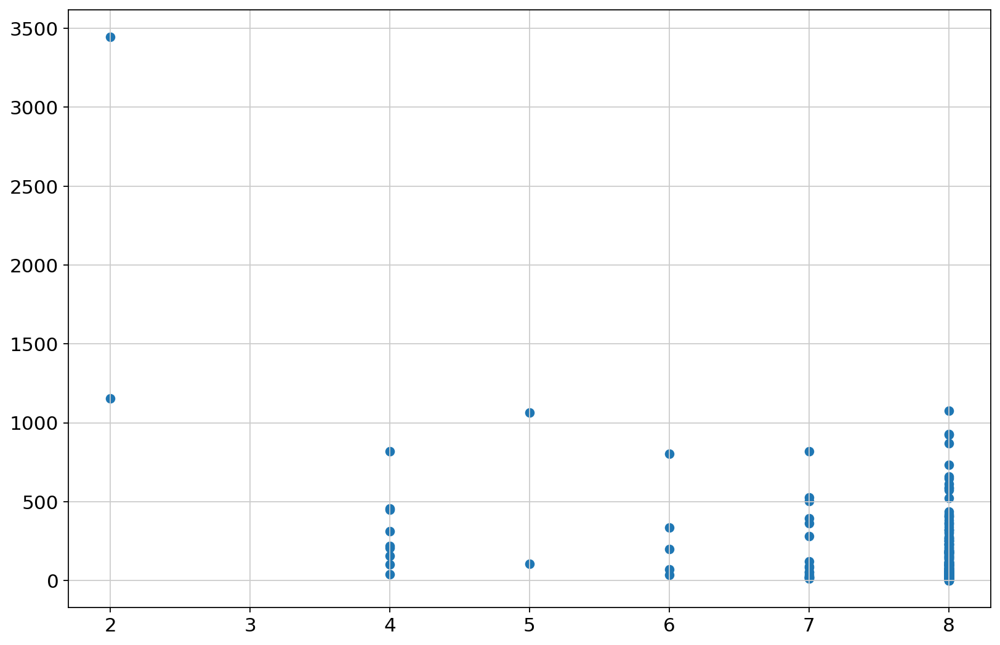

In [549]:
plt.scatter(expre['nprobes'],expre['visium'])

In [ ]:
sc.pl.spatial(xenium,color='col19a1',spot_size=100,vmax=3)
sc.pl.spatial(visiumFF,color='col19a1',img_key=None)

In [ ]:
sc.pl.spatial(xenium,color='col19a1',spot_size=100,vmax=3)
sc.pl.spatial(visiumFF,color='col19a1',img_key=None)
plt.figure()
plt.scatter(expre['visium'],expre['ratio'])

In [535]:
visiumFF.obs['total_counts']=list(np.sum(visiumFF.to_df(),axis=1).astype(int))

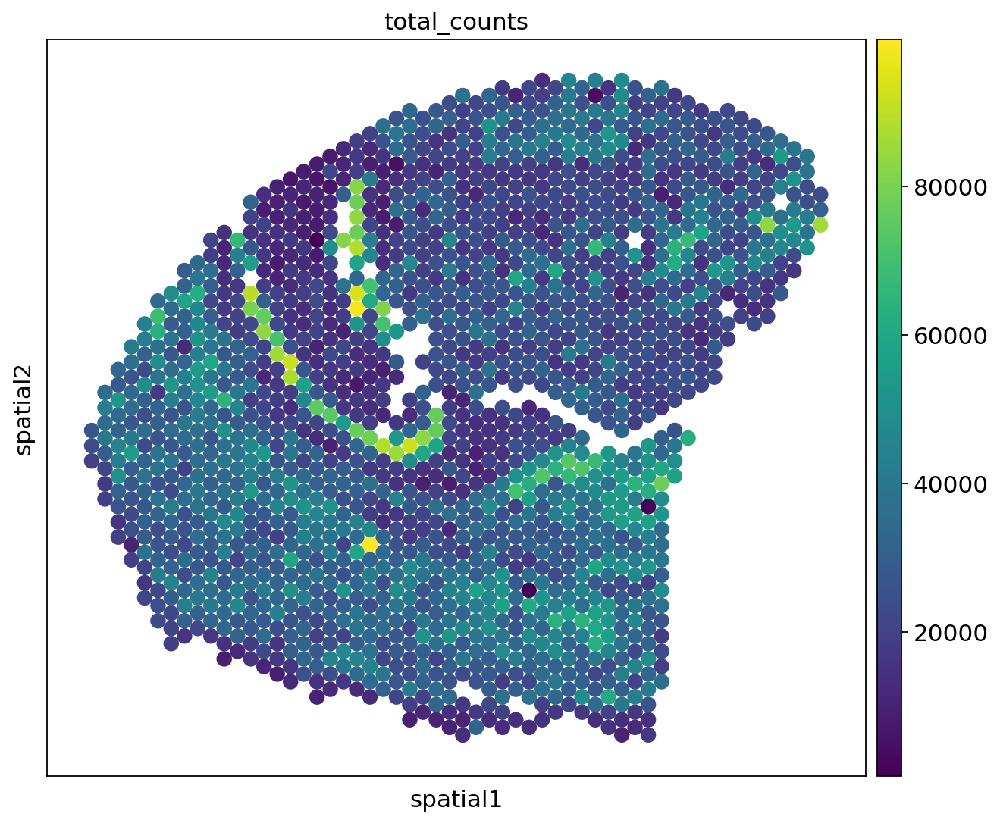

In [536]:
sc.pl.spatial(visiumFF,color='total_counts',spot_size=140,img_key=None)

In [551]:
xenium.obs['total_counts']=list(np.sum(xenium.to_df(),axis=1).astype(int))

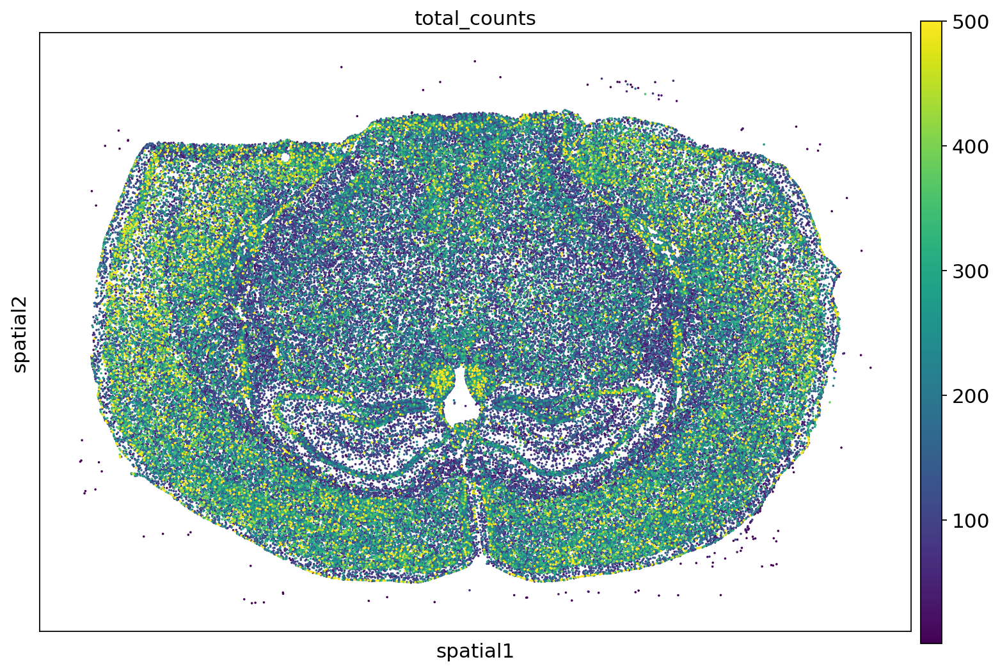

In [554]:
sc.pl.spatial(xenium,color='total_counts',spot_size=140,img_key=None,vmax=500)

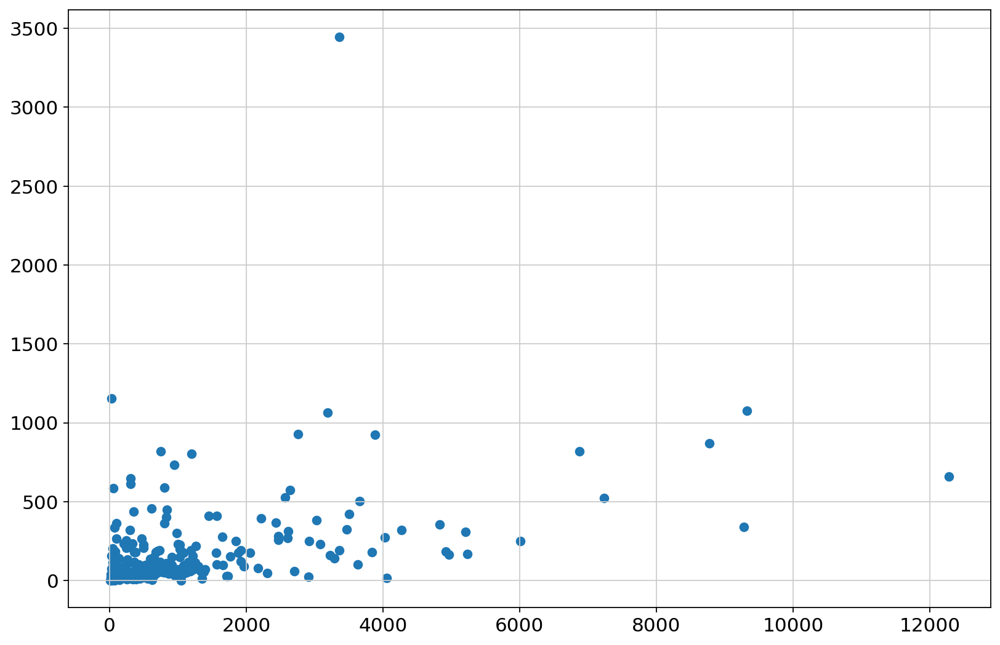

In [570]:
plt.scatter(expre['xenium'],expre['visium'])

(0.0, 100.0)

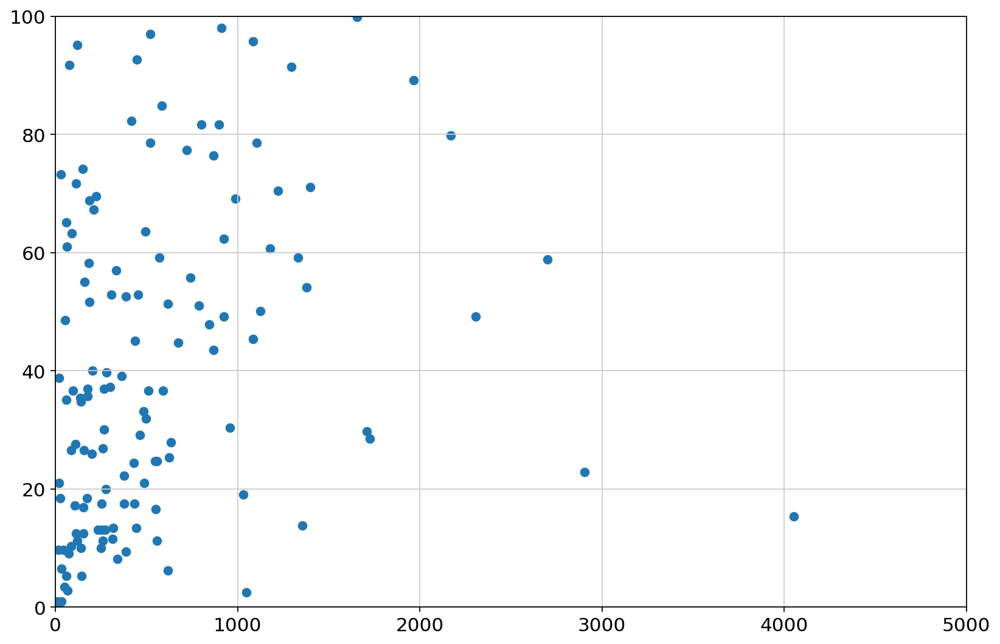

In [559]:
plt.scatter(expre['xenium'],expre['visium'])
plt.xlim([0,5000])
plt.ylim([0,100])

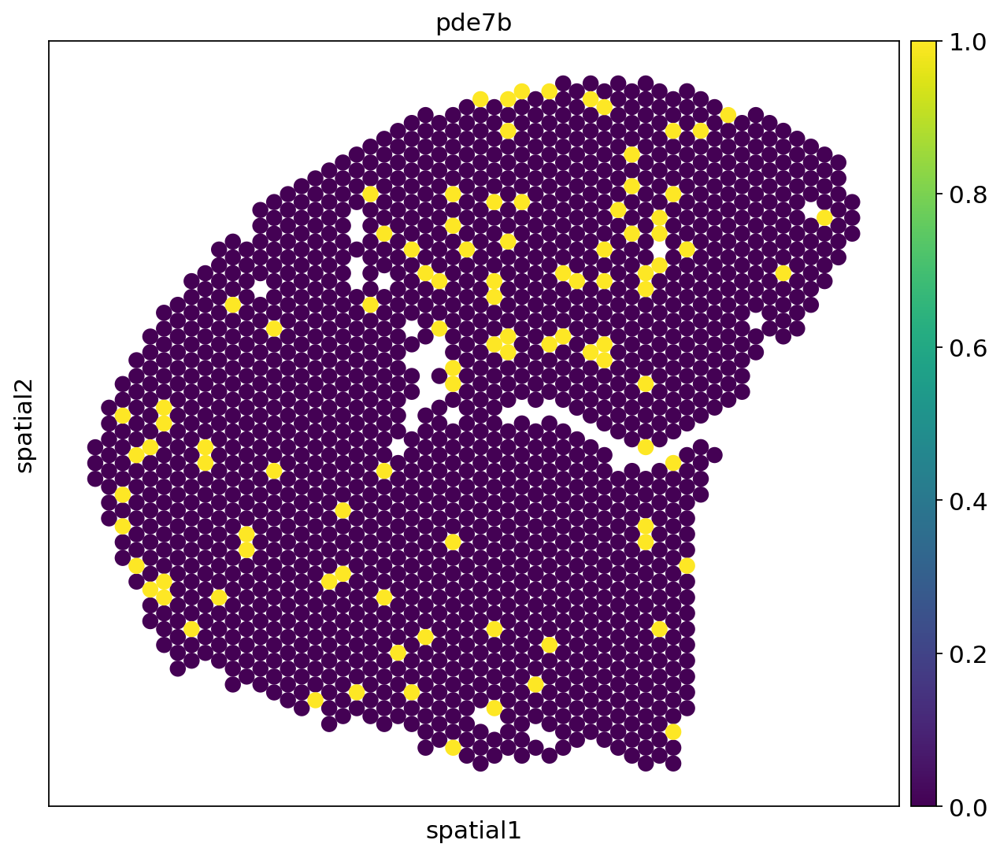

In [567]:
sc.pl.spatial(visiumFF,color=['pde7b'],spot_size=140,img_key=None,vmax='p99')

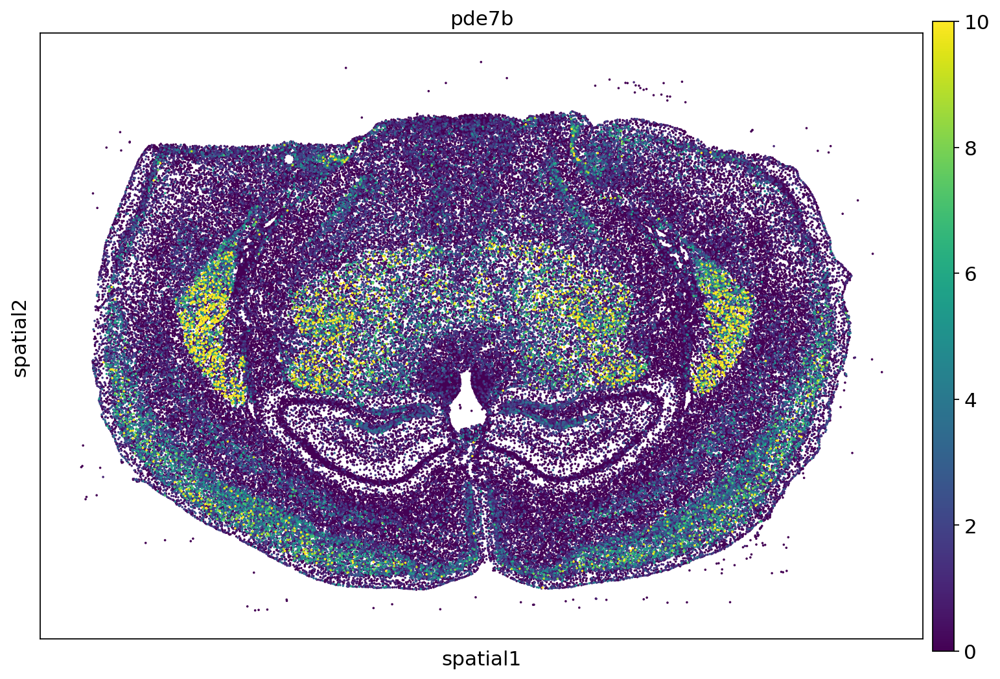

In [563]:
sc.pl.spatial(xenium,color=['pde7b'],spot_size=140,img_key=None,vmax='p99')

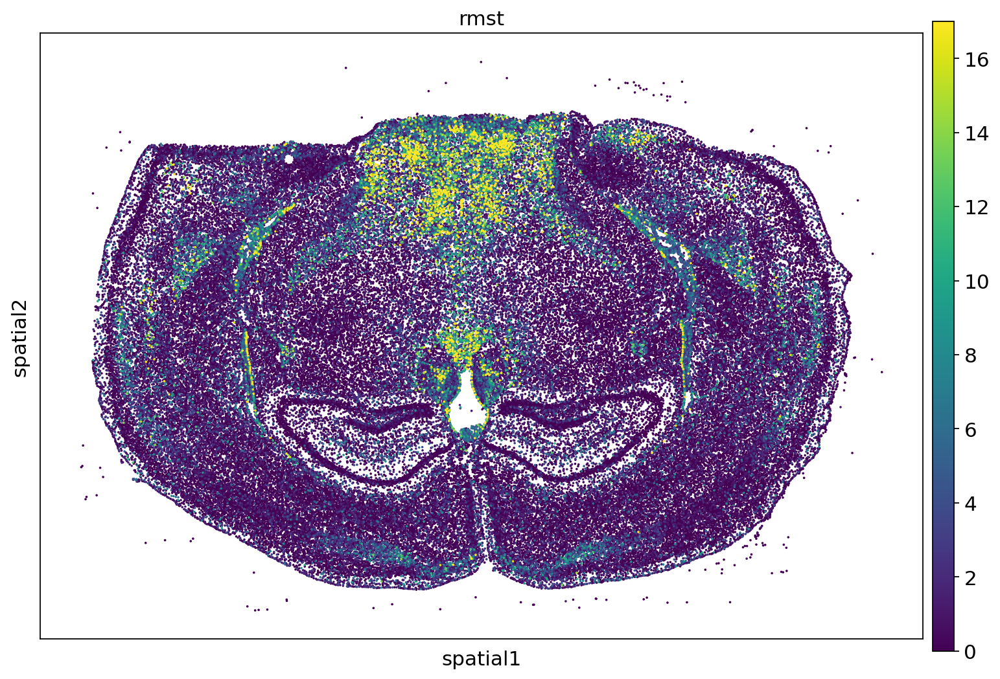

In [564]:
sc.pl.spatial(xenium,color=['rmst'],spot_size=140,img_key=None,vmax='p99')

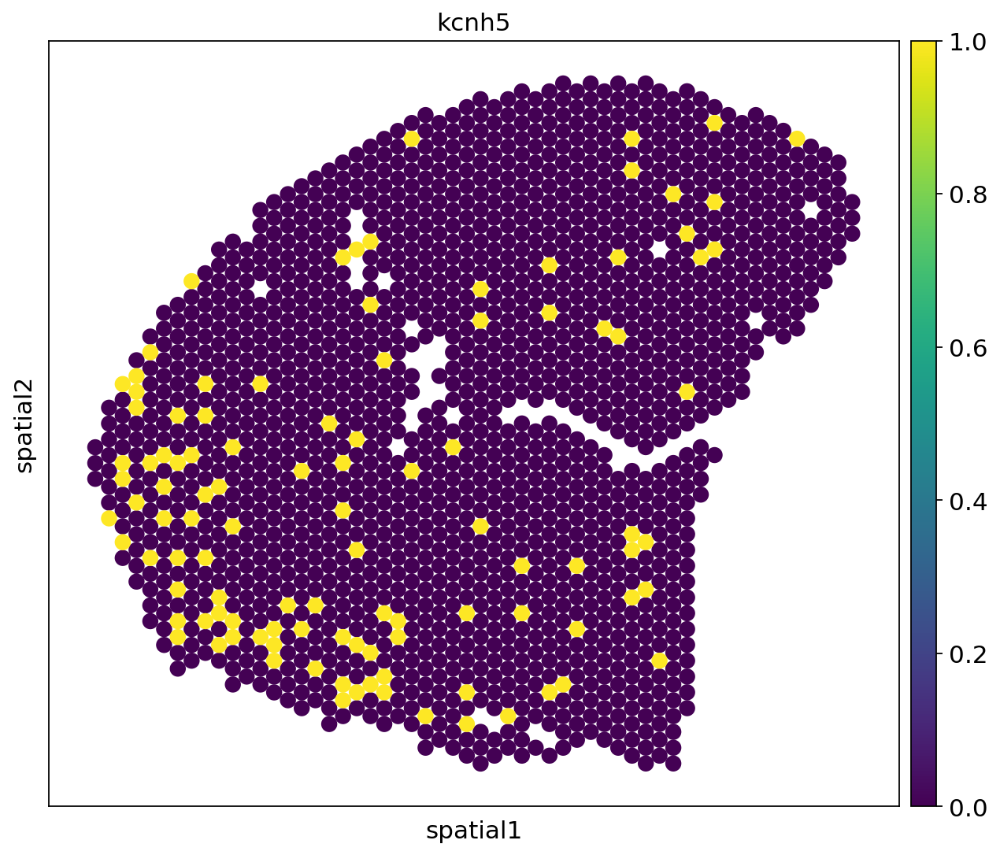

In [566]:
sc.pl.spatial(visiumFF,color=['kcnh5'],spot_size=140,img_key=None,vmax='p99')

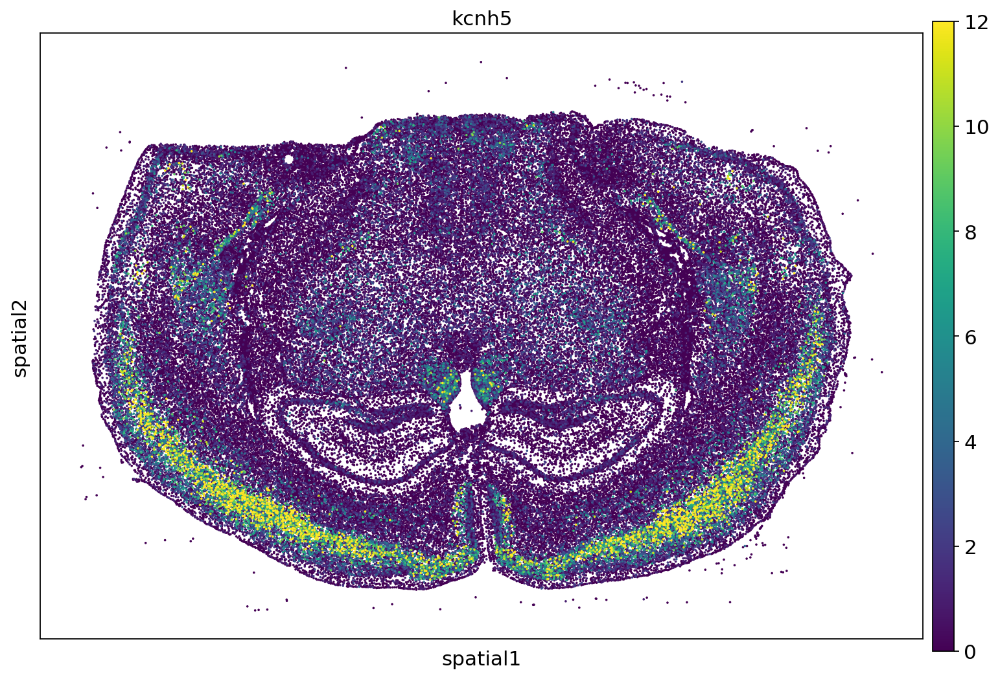

In [565]:
sc.pl.spatial(xenium,color=['kcnh5'],spot_size=140,img_key=None,vmax='p99')

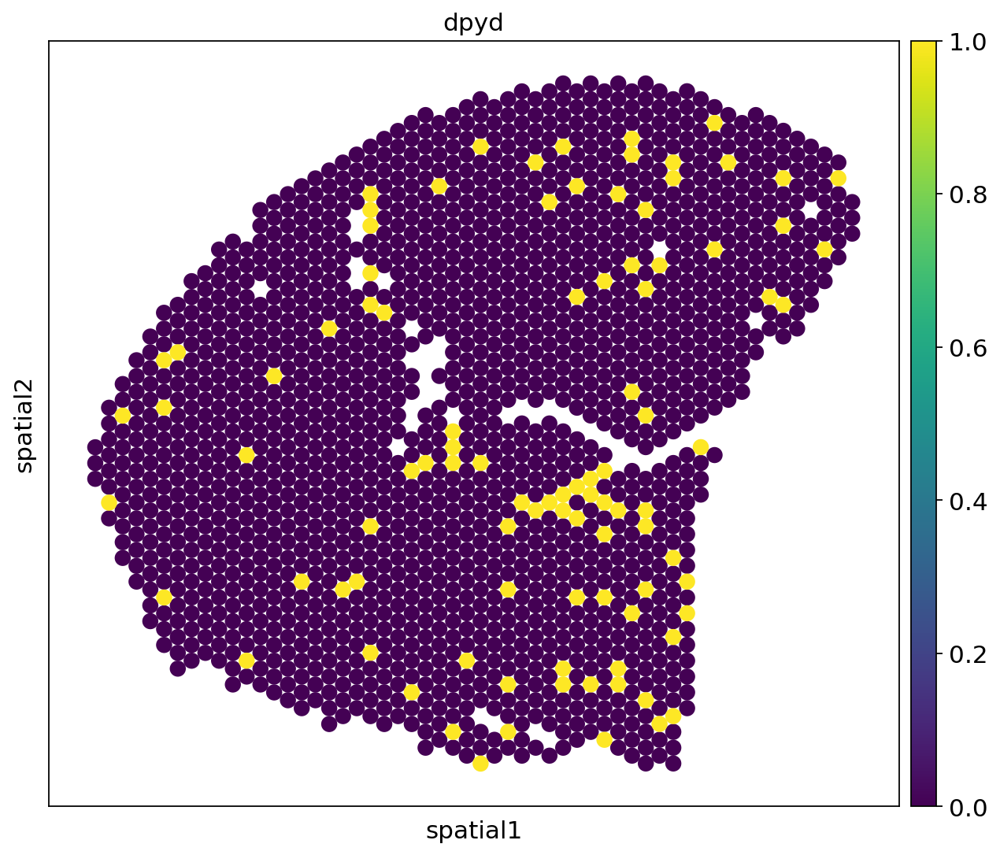

In [568]:
sc.pl.spatial(visiumFF,color=['dpyd'],spot_size=140,img_key=None,vmax='p99')

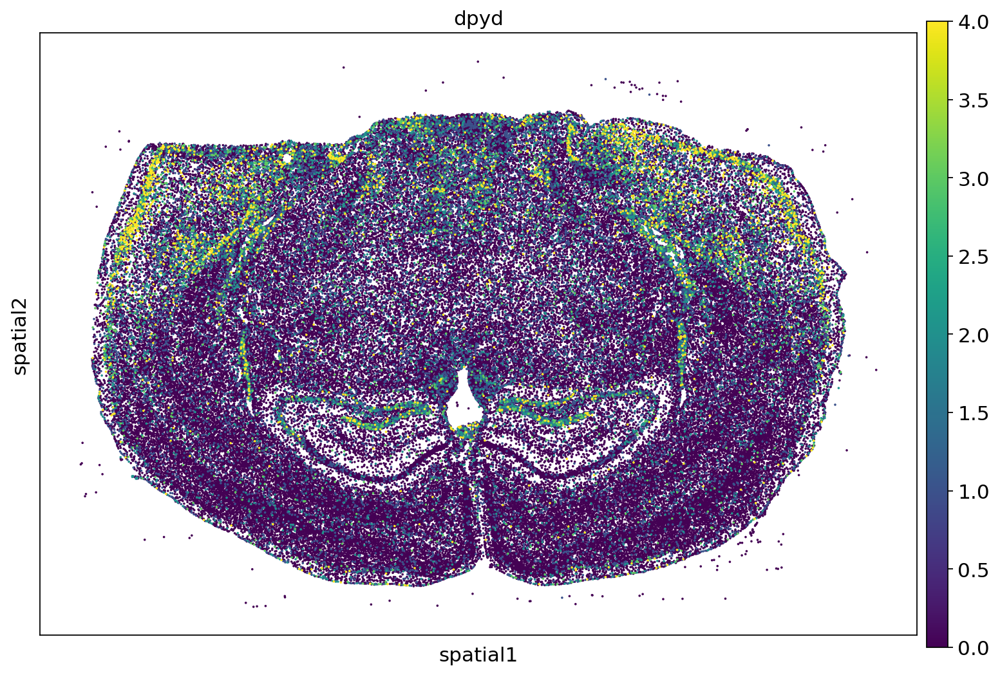

In [569]:
sc.pl.spatial(xenium,color=['dpyd'],spot_size=140,img_key=None,vmax='p99')